<a href="https://colab.research.google.com/github/shahkarKhan24/Image-to-Image-Translation-Using-Conditional-GANs/blob/main/Image_to_Image_Translation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h3>Image-To-Image Translation Using GANs</h3>
<p>
Here we are trying to use conditional adverserial networks to solve general purpose solution of image to imag translation. This netwrok can be use for Segementaion , colorin, or styling of an image given the dataset. Here we are trying to convert settelite images into google map type images.

</p>
<h4>Dataset</h4>
<p>The data set was download from kaggle which was specifically made for this kind of task. it contains a combine images of input and target which we split it during preprocessing</p>

In [ ]:
import torch
import torch.nn as nn
import numpy as np
import os
from PIL import Image
import torchvision
from torch.utils.data import Dataset, DataLoader
from torchvision.utils import save_image, make_grid
import torch.optim as optim

from tqdm import tqdm


In [ ]:
import gc

gc.collect()
torch.cuda.empty_cache()

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, in_channels=3, out=[64, 128, 256, 512]):
        super().__init__()

        self.initial = nn.Sequential(
            nn.Conv2d(
                in_channels * 2, # here we are sending it input image as well as output image
                out[0],
                kernel_size=4,
                stride=2,
                padding=1,
                padding_mode="reflect",
            ),
            nn.LeakyReLU(0.2),
        )# no batch norm in the initial block as per paper

        layer1 = nn.Conv2d(
            out[0],
            out[1],
            kernel_size=4,
            stride=2,
            padding=1,
            bias=False,
            padding_mode="reflect",
        )
        layer2 = nn.BatchNorm2d(out[1])
        layer3 = nn.LeakyReLU(0.2)

        layer4 = nn.Conv2d(
            out[1],
            out[2],
            kernel_size=4,
            stride=2,
            padding=1,
            bias=False,
            padding_mode="reflect",
        )
        layer5 = nn.BatchNorm2d(out[2])
        layer6 = nn.LeakyReLU(0.2)

        layer7 = nn.Conv2d(
            out[2],
            out[3],
            kernel_size=4,
            stride=1,
            padding=1,
            bias=False,
            padding_mode="reflect",
        )
        layer8 = nn.BatchNorm2d(out[3])
        layer9 = nn.LeakyReLU(0.2)

        layer10 = nn.Conv2d(
            out[3],
            1,
            kernel_size=4,
            stride=1,
            padding=1,
            padding_mode="reflect",
        )

        self.model = nn.Sequential(
            layer1, #Conv2d
            layer2, #BatchNorm
            layer3, #Leaky Relu
            layer4, #Conv2d
            layer5, #BatchNorm
            layer6, #Leaky Relu
            layer7, #Conv2d
            layer8, #BatchNorm
            layer9, #Leaky Relu
            layer10, #Conv2d with output 1
        )

    def forward(self, x, y):
        x = torch.cat([x, y], dim=1)
        x = self.initial(x)
        x = self.model(x)
        return x

In [ ]:
def test():
    x = torch.randn((1, 3, 256, 256))
    y = torch.randn((1, 3, 256, 256))
    model = Discriminator(in_channels=3)
    preds = model(x, y)
    # print(model)
    print(preds.shape)

test()

torch.Size([1, 1, 30, 30])


In [ ]:
class Block(nn.Module):
    def __init__(self, in_channels, out_channels, down=True, act="relu", use_dropout=False):
        super(Block, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 4, 2, 1, bias=False, padding_mode="reflect")
            if down
            else nn.ConvTranspose2d(in_channels, out_channels, 4, 2, 1, bias=False), # we cannot use padding_mode =reflect in conv transpose
            nn.BatchNorm2d(out_channels),
            nn.ReLU() if act == "relu" else nn.LeakyReLU(0.2),
        )

        self.use_dropout = use_dropout
        self.dropout = nn.Dropout(0.5)
        self.down = down

    def forward(self, x):
        x = self.conv(x)
        return self.dropout(x) if self.use_dropout else x


In [ ]:
class Generator(nn.Module):
    def __init__(self, in_channels=3, features=64):
        super().__init__()
        self.initial = nn.Sequential(
            nn.Conv2d(in_channels, features, 4, 2, 1, padding_mode="reflect"),
            nn.LeakyReLU(0.2),)                                                                    #128
        # The hyper parameters like input and output of each layer has been taken from the original source code
        self.down1 = Block(features, features * 2, down=True, act="leaky", use_dropout=False)      #64
        self.down2 = Block(features * 2, features * 4, down=True, act="leaky", use_dropout=False)  #32
        self.down3 = Block(features * 4, features * 8, down=True, act="leaky", use_dropout=False)  #16
        self.down4 = Block(features * 8, features * 8, down=True, act="leaky", use_dropout=False)  #8
        self.down5 = Block(features * 8, features * 8, down=True, act="leaky", use_dropout=False)  #4
        self.down6 = Block(features * 8, features * 8, down=True, act="leaky", use_dropout=False)  #2

        self.bottleneck = nn.Sequential(
            nn.Conv2d(features * 8, features * 8, 4, 2, 1), nn.ReLU()
        )                                                                                          #1x1

        self.up1 = Block(features * 8, features * 8, down=False, act="relu", use_dropout=True)
        self.up2 = Block(features * 8 * 2, features * 8, down=False, act="relu", use_dropout=True)
        self.up3 = Block(features * 8 * 2, features * 8, down=False, act="relu", use_dropout=True)
        self.up4 = Block(features * 8 * 2, features * 8, down=False, act="relu", use_dropout=False)
        self.up5 = Block(features * 8 * 2, features * 4, down=False, act="relu", use_dropout=False)
        self.up6 = Block(features * 4 * 2, features * 2, down=False, act="relu", use_dropout=False)
        self.up7 = Block(features * 2 * 2, features, down=False, act="relu", use_dropout=False)
        self.final = nn.Sequential(
            nn.ConvTranspose2d(features * 2, in_channels, kernel_size=4, stride=2, padding=1),
            nn.Tanh(),
        )

    def forward(self, x):
        d1 = self.initial(x)
        d2 = self.down1(d1)
        d3 = self.down2(d2)
        d4 = self.down3(d3)
        d5 = self.down4(d4)
        d6 = self.down5(d5)
        d7 = self.down6(d6)
        latent = self.bottleneck(d7)
        up1 = self.up1(latent)
        # From here we are also concatinating the residual or skip connection just like a U-Net accros first dimension
        up2 = self.up2(torch.cat([up1, d7], 1))
        up3 = self.up3(torch.cat([up2, d6], 1))
        up4 = self.up4(torch.cat([up3, d5], 1))
        up5 = self.up5(torch.cat([up4, d4], 1))
        up6 = self.up6(torch.cat([up5, d3], 1))
        up7 = self.up7(torch.cat([up6, d2], 1))

        return self.final(torch.cat([up7, d1], 1))


In [ ]:
def test():
    x = torch.randn((1, 3, 256, 256))
    model = Generator(in_channels=3, features=64)
    preds = model(x)
    print(preds.shape)



test()

torch.Size([1, 3, 256, 256])


In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
TRAIN_DIR = "dataset_maps/maps/train"
VAL_DIR = "dataset_maps/maps/val"
LEARNING_RATE = 2e-4
BATCH_SIZE = 16
IMAGE_SIZE = 256
CHANNELS_IMG = 3
L1_LAMBDA = 100
LAMBDA_GP = 10
NUM_EPOCHS = 200
LOAD_MODEL = True
SAVE_MODEL = True
CHECKPOINT_DISC = "disc.pth.tar"
CHECKPOINT_GEN = "gen.pth.tar"

In [ ]:

transform = A.Compose([A.Resize(width=256, height=256),], additional_targets={"image0": "image"},)

transform_input = A.Compose([A.HorizontalFlip(p=0.5),A.ColorJitter(p=0.2),
        A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5], max_pixel_value=255.0,),
        ToTensorV2(),])

transform_target = A.Compose([A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5], max_pixel_value=255.0,),
        ToTensorV2(),])

In [ ]:
class MapDataset(Dataset):
    def __init__(self, root_dir):
        self.root_dir = root_dir
        self.list_files = os.listdir(self.root_dir)

    def __len__(self):
        return len(self.list_files)

    def __getitem__(self, index):
        img_file = self.list_files[index]
        img_path = os.path.join(self.root_dir, img_file)
        image = np.array(Image.open(img_path))

        # Since in the datset both input and desired mask output are combined here we are spliting it into input and mask output image

        input_image = image[:, :600, :]
        target_image = image[:, 600:, :]

        augmentations = transform(image=input_image, image0=target_image)
        input_image = augmentations["image"]
        target_image = augmentations["image0"]

        input_image = transform_input(image=input_image)["image"]
        target_image = transform_target(image=target_image)["image"]

        return input_image, target_image


Below block of code is simply used for saving some example into our device during training

In [ ]:
def save_some_examples(gen, val_loader, epoch, folder):
    x, y = next(iter(val_loader))
    x, y = x.to(DEVICE), y.to(DEVICE)
    gen.eval()
    with torch.no_grad():
        y_fake = gen(x)
        y_fake = y_fake * 0.5 + 0.5  # remove normalization#
        save_image(y_fake, folder + f"/y_gen_{epoch}.png")
        save_image(x * 0.5 + 0.5, folder + f"/input_{epoch}.png")
        # save_image(x, folder + f"/input_{epoch}.png")
        if epoch == 1:
            save_image(y * 0.5 + 0.5, folder + f"/label_{epoch}.png")
    gen.train()


Below Block of codee is only used for visualizing some output or input during or after traning

In [ ]:
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt

def show_image(img, title):
    img = img / 2 + 0.5 # unnormalize
    npimg = img.numpy() # convert from tensor
    figure(figsize=(15, 6), dpi=80)
    plt.title(title, loc = 'center')
    plt.imshow(np.transpose(npimg, (1, 2, 0))) #Convert (3,32,32) to (32,32,3)
    plt.show()


Below code is taken from some utill file on internet just to use when we want to save or load our model at certain stage of training or testing [here]

In [ ]:
def save_checkpoint(model, optimizer, filename="my_checkpoint.pth.tar"):
    print("=> Saving checkpoint")
    checkpoint = {
        "state_dict": model.state_dict(),
        "optimizer": optimizer.state_dict(),
    }
    torch.save(checkpoint, filename)


def load_checkpoint(checkpoint_file, model, optimizer, lr):
    print("=> Loading checkpoint")
    checkpoint = torch.load(checkpoint_file, map_location=DEVICE)
    model.load_state_dict(checkpoint["state_dict"])
    optimizer.load_state_dict(checkpoint["optimizer"])

    # If we don't do this then it will just have learning rate of old checkpoint
    # and it will lead to many hours of debugging \:
    for param_group in optimizer.param_groups:
        param_group["lr"] = lr


In [ ]:
torch.backends.cudnn.benchmark = True

In [ ]:
def train_fn(disc, gen, loader, opt_disc, opt_gen, l1_loss, bce, g_scaler, d_scaler,):
    loop = tqdm(loader, leave=True)

    for idx, (x, y) in enumerate(loop):
        x = x.float().to(DEVICE)
        y = y.float().to(DEVICE)

        # Train Discriminator
        with torch.cuda.amp.autocast(): #float 16 training
            fake = gen(x)
            real = disc(x, y)
            Des_real_loss = bce(real, torch.ones_like(real))
            Des_fake = disc(x, fake.detach())
            Des_fake_loss = bce(Des_fake, torch.zeros_like(Des_fake))
            Des_loss = (Des_real_loss + Des_fake_loss) / 2

        disc.zero_grad()
        d_scaler.scale(Des_loss).backward()
        d_scaler.step(opt_disc)
        d_scaler.update()

        # Train generator
        with torch.cuda.amp.autocast():
            Des_fake = disc(x, fake)
            Gen_fake_loss = bce(Des_fake, torch.ones_like(Des_fake))
            L1 = l1_loss(fake, y) *L1_LAMBDA
            Gen_loss = Gen_fake_loss + L1

        opt_gen.zero_grad()
        g_scaler.scale(Gen_loss).backward()
        g_scaler.step(opt_gen)
        g_scaler.update()

        # if idx % 10 == 0:
        #     loop.set_postfix(
        #         D_real=torch.sigmoid(D_real).mean().item(),
        #         D_fake=torch.sigmoid(D_fake).mean().item(),
        #     )

In [ ]:
disc = Discriminator(in_channels=3).to(DEVICE)
gen = Generator(in_channels=3, features=64).to(DEVICE)
opt_disc = optim.Adam(disc.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999),)
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))
BCE = nn.BCEWithLogitsLoss()
L1_LOSS = nn.L1Loss()

=> Loading checkpoint


=> Loading checkpoint


100%|██████████| 69/69 [02:42<00:00,  2.35s/it]


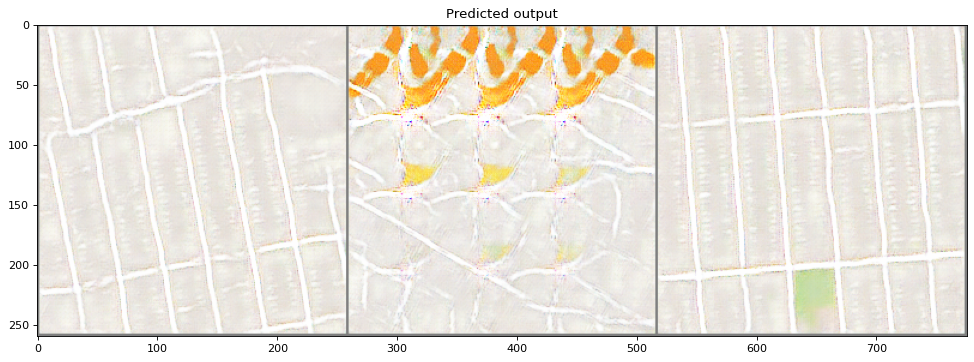

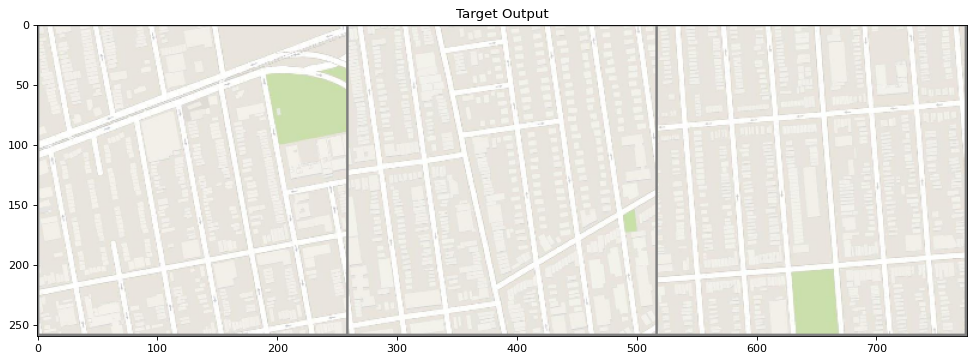

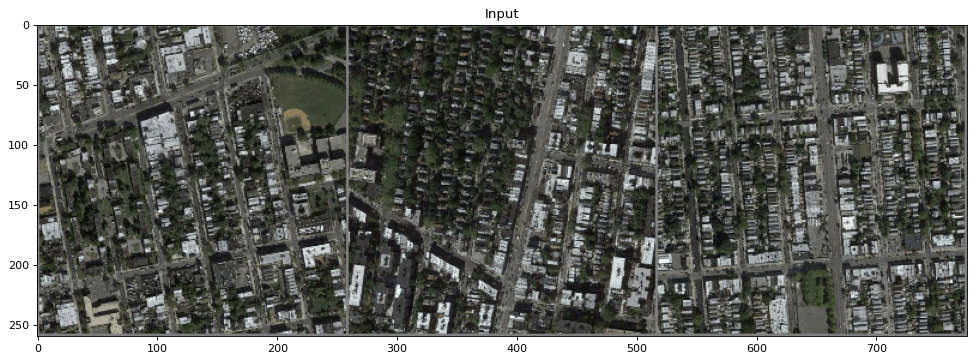

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [01:31<00:00,  1.33s/it]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [01:34<00:00,  1.37s/it]


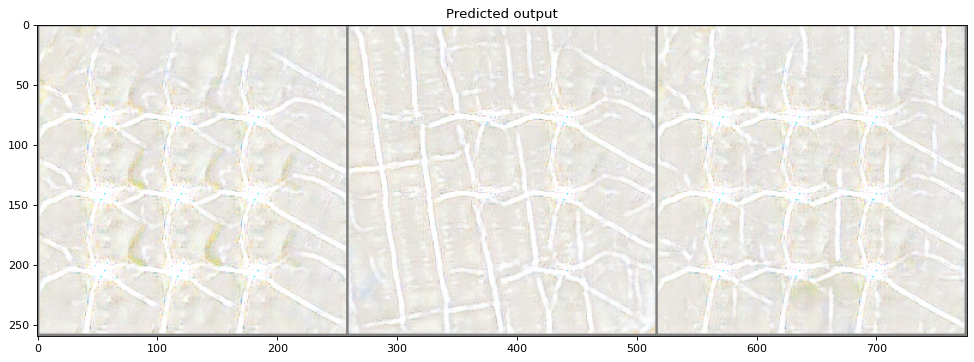

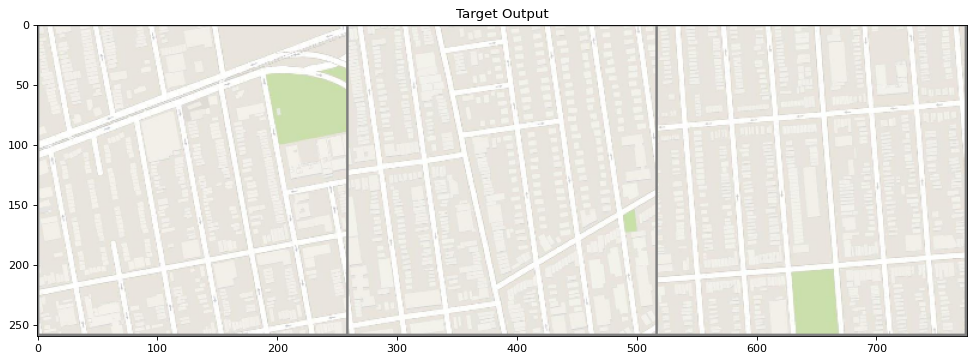

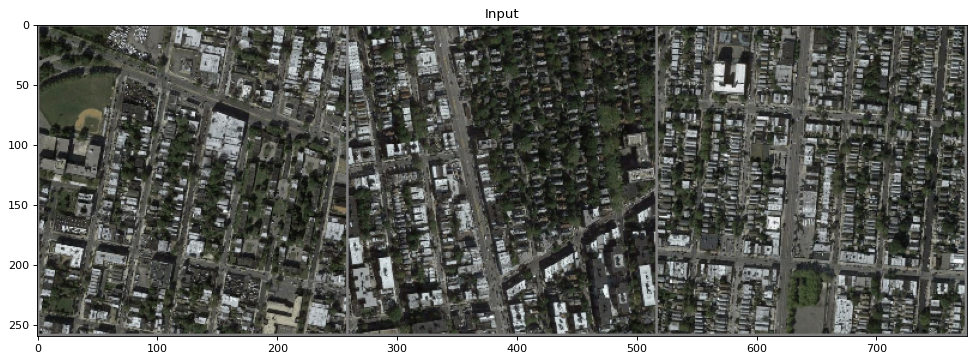

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [01:33<00:00,  1.36s/it]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [01:31<00:00,  1.33s/it]


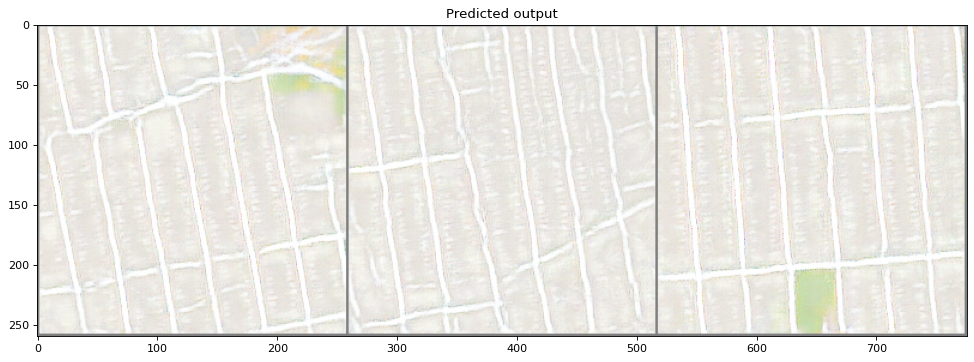

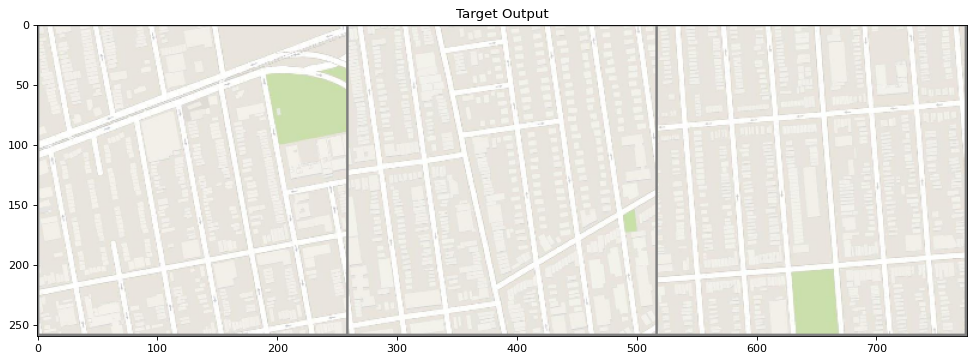

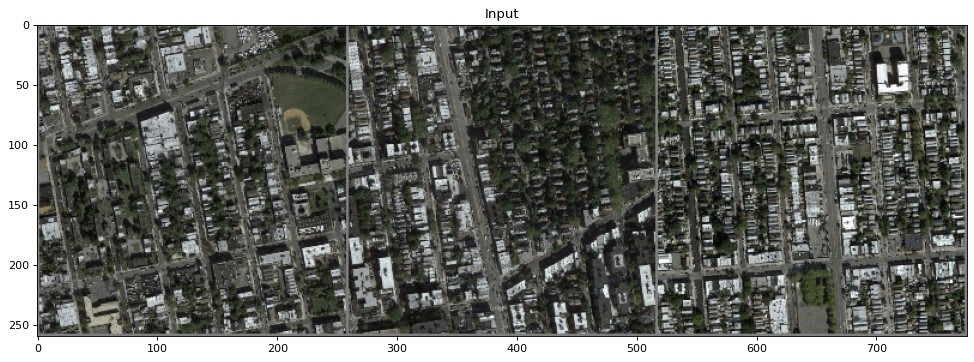

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [01:34<00:00,  1.37s/it]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [01:34<00:00,  1.36s/it]


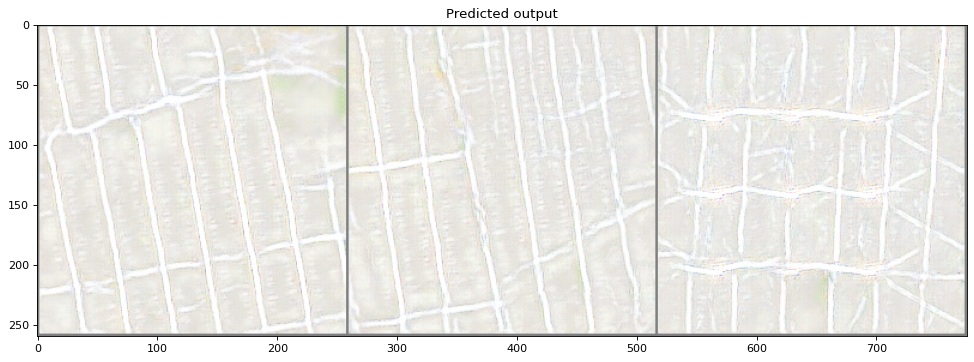

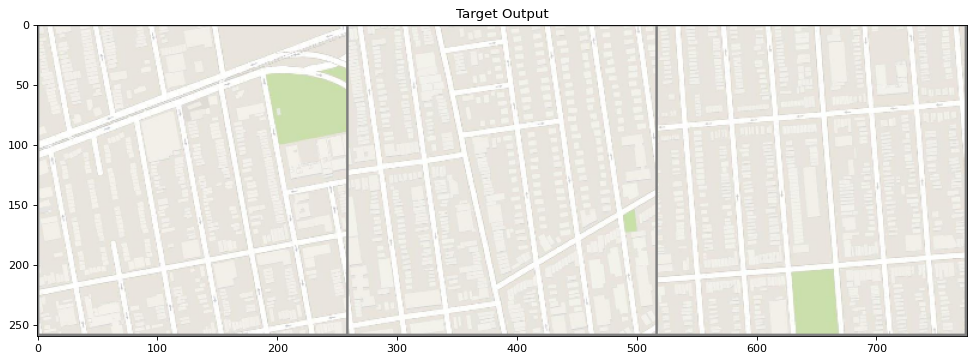

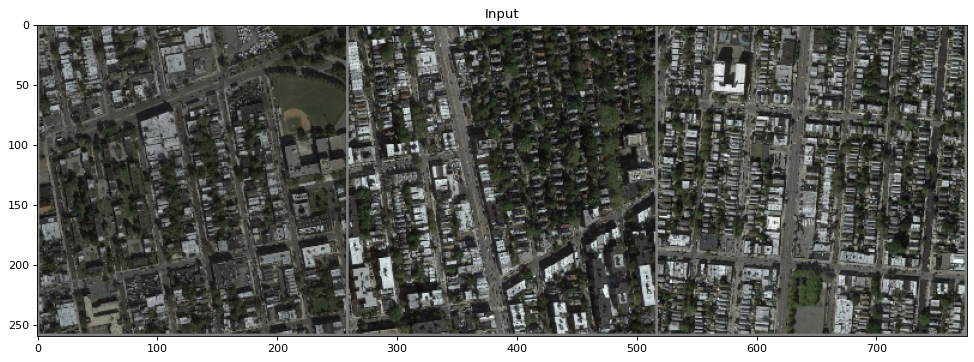

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [04:02<00:00,  3.51s/it]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  1.97it/s]


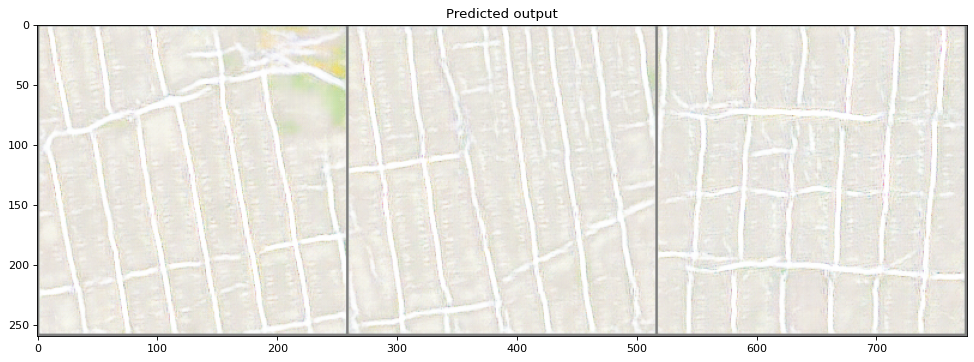

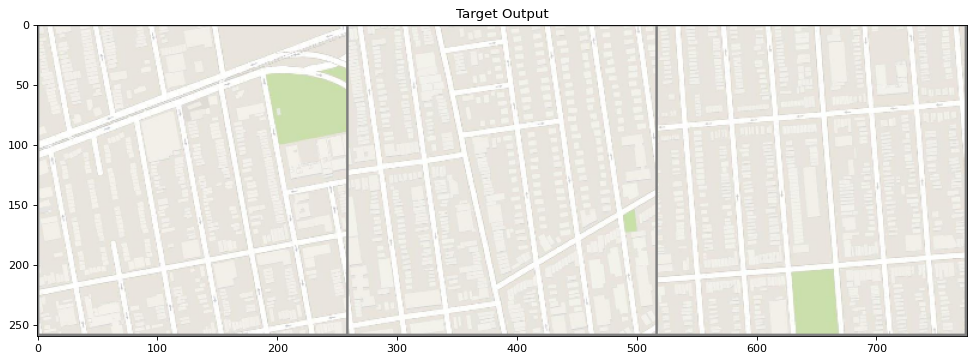

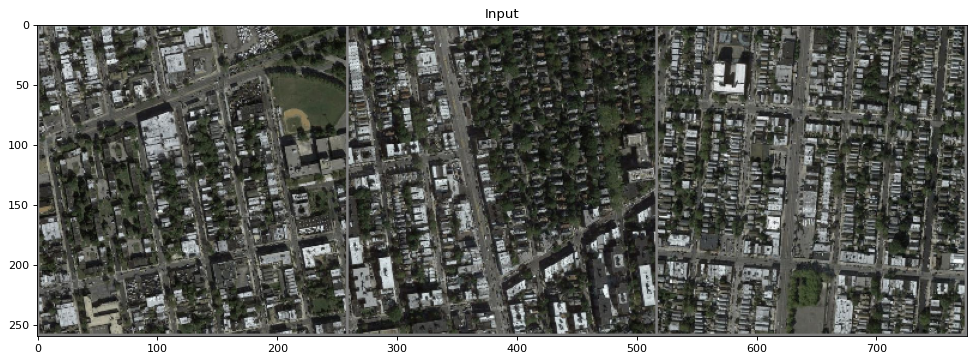

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:33<00:00,  2.04it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.02it/s]


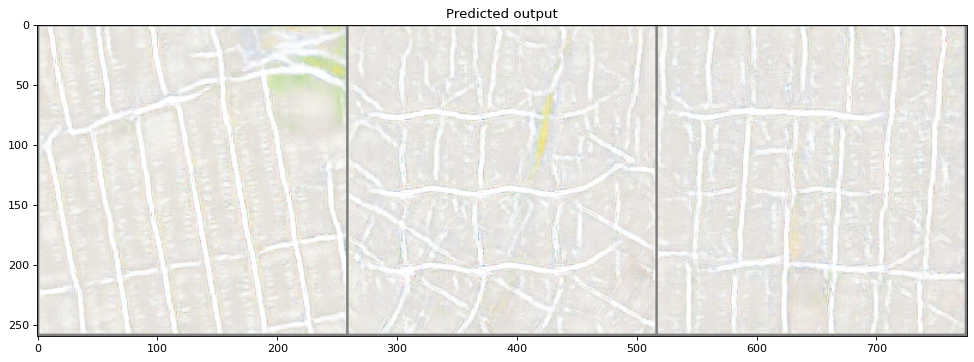

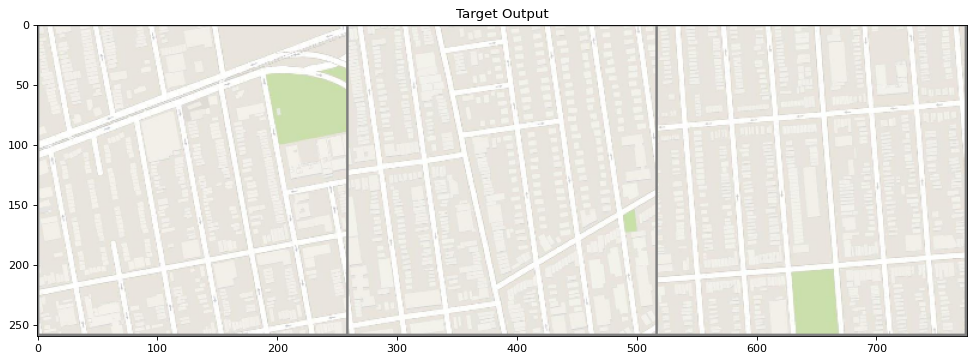

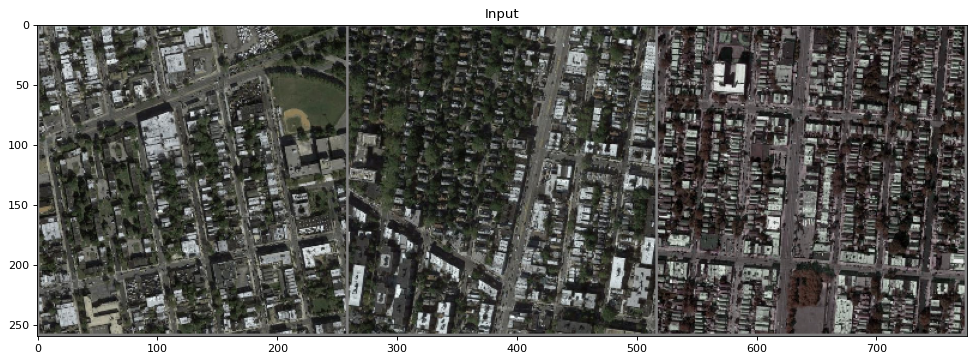

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.02it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.02it/s]


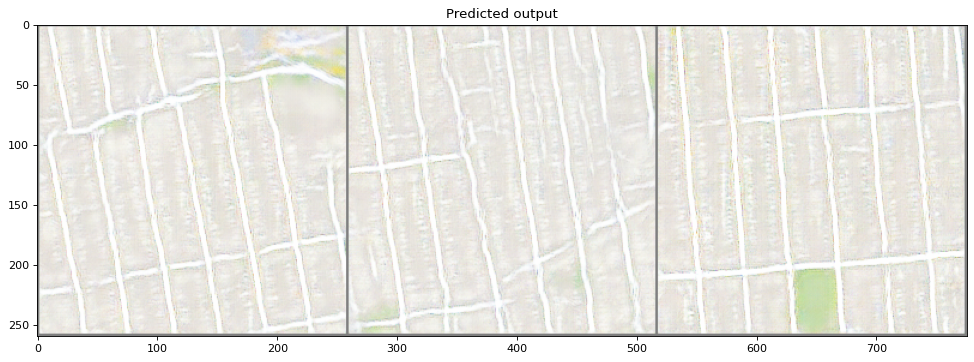

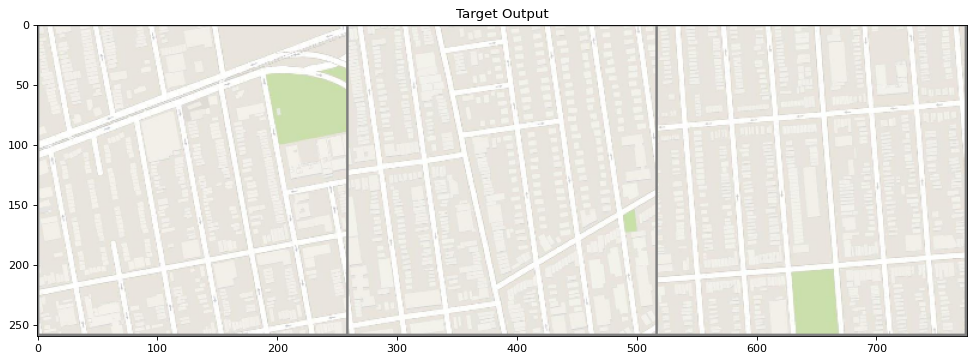

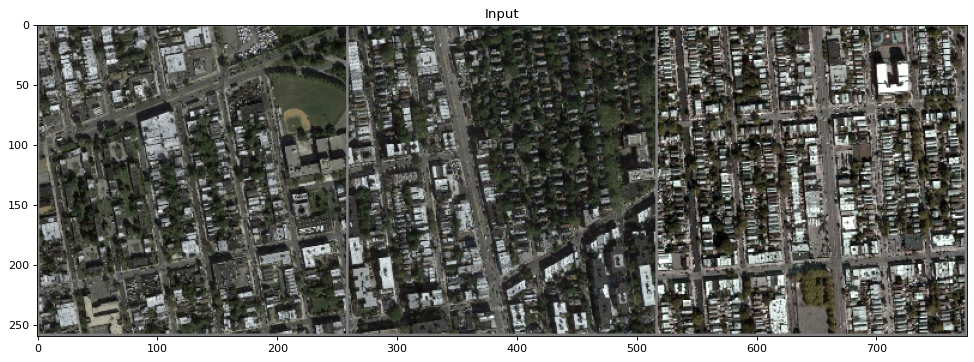

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


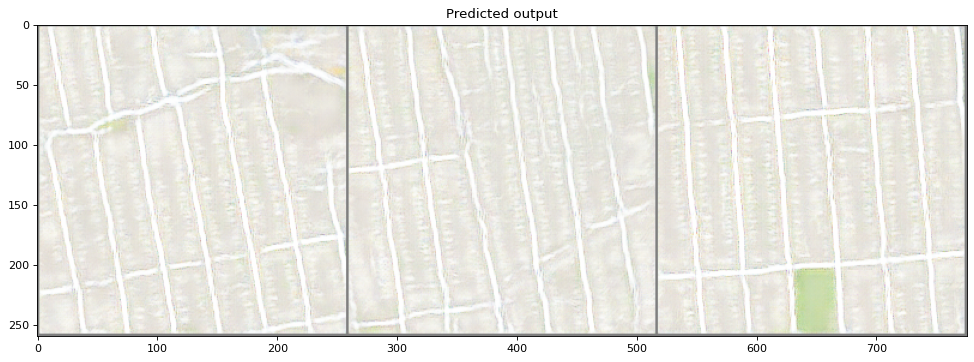

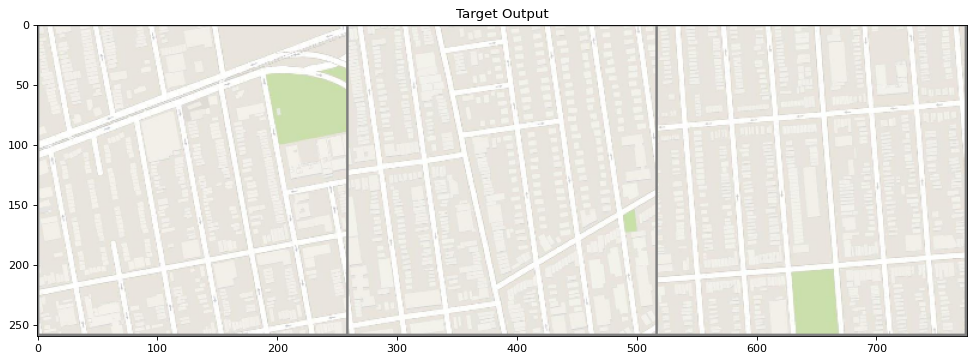

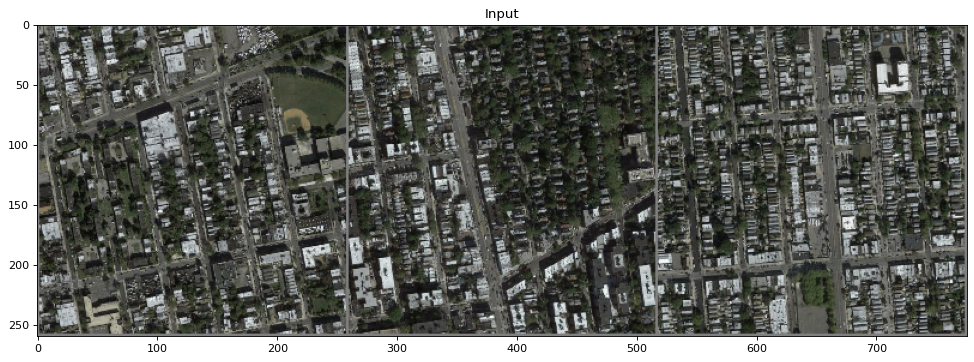

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


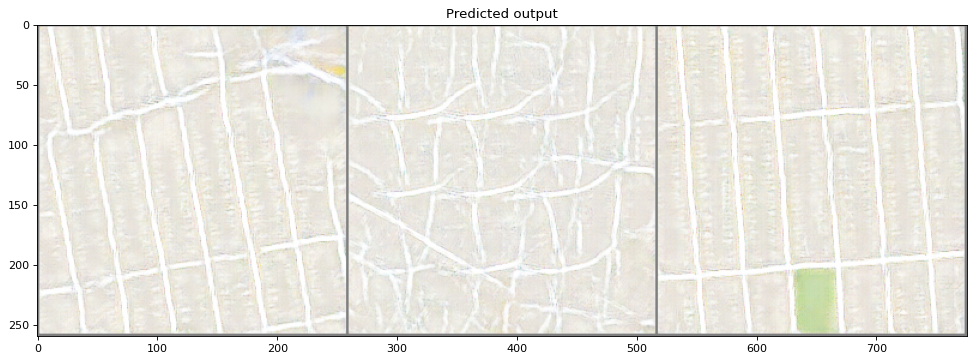

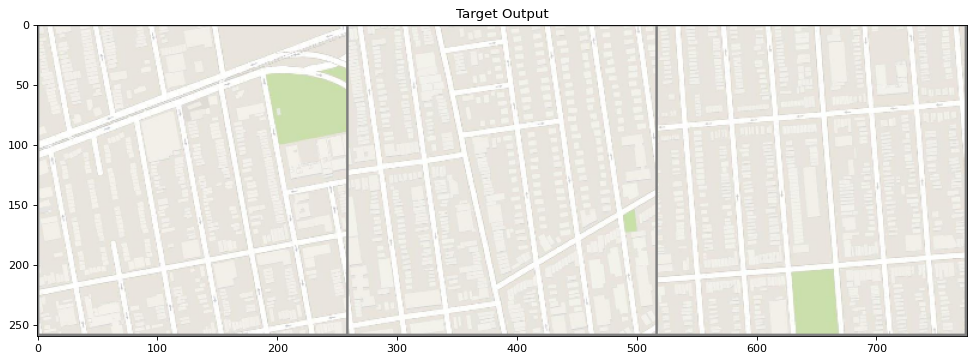

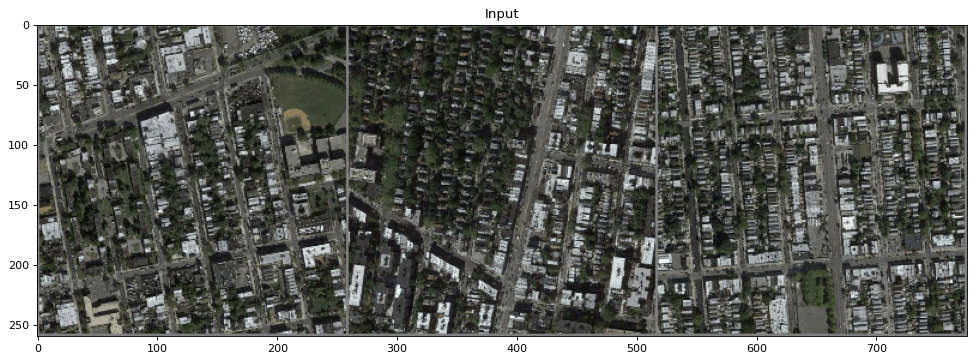

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.02it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:35<00:00,  1.94it/s]


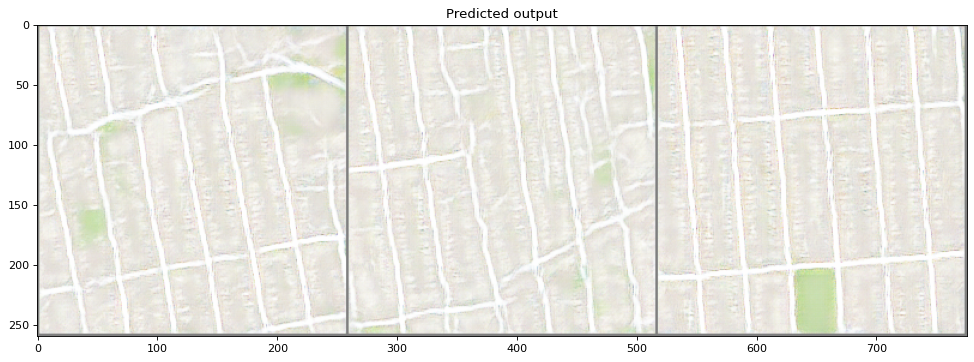

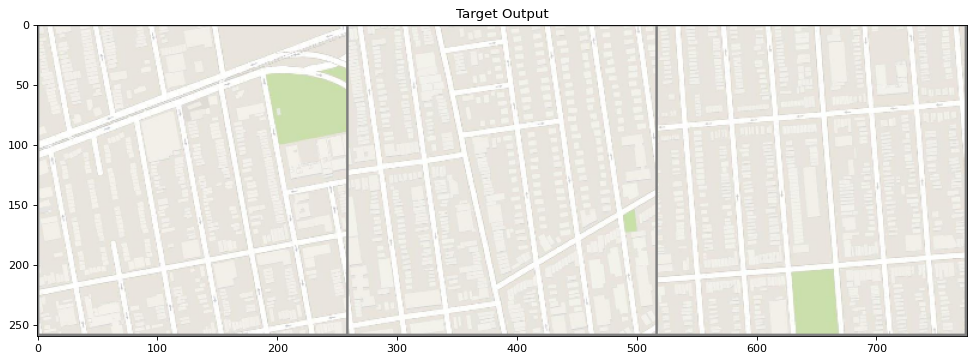

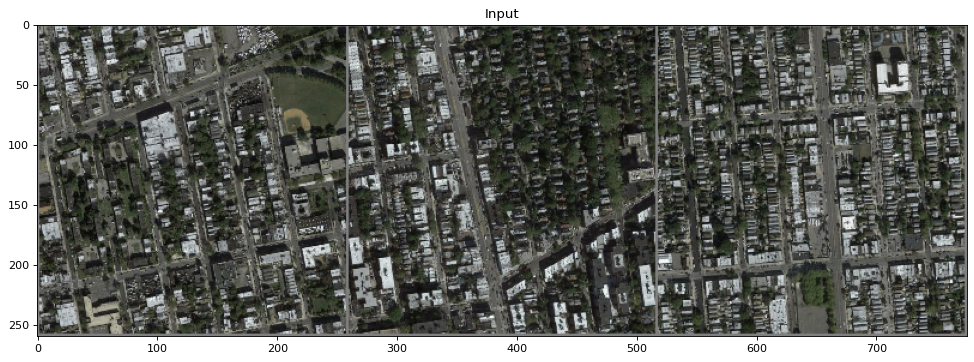

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.00it/s]


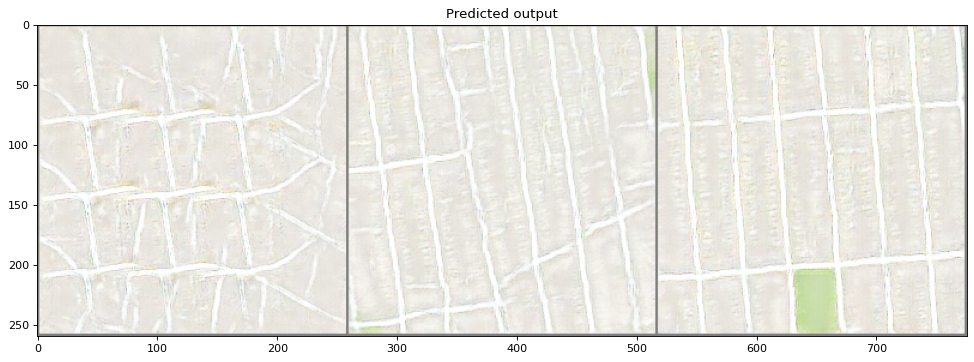

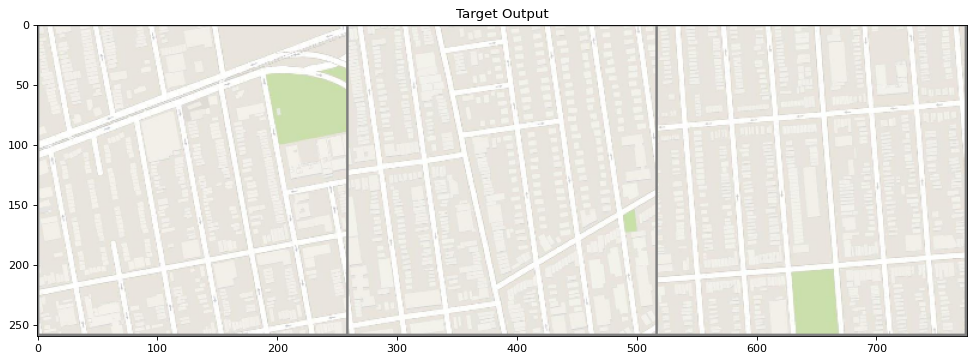

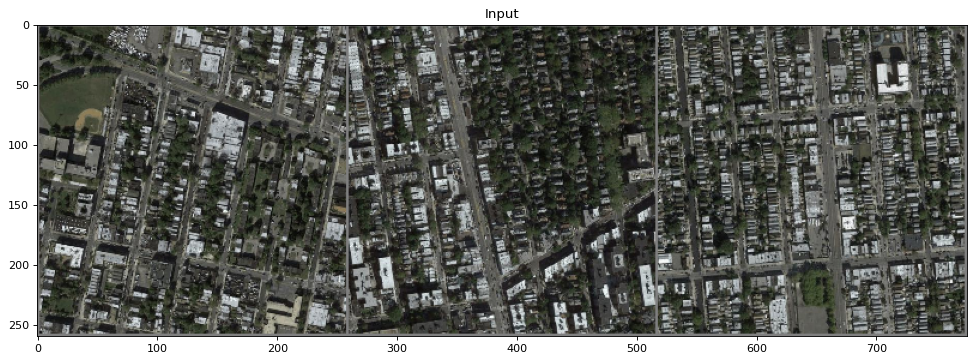

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


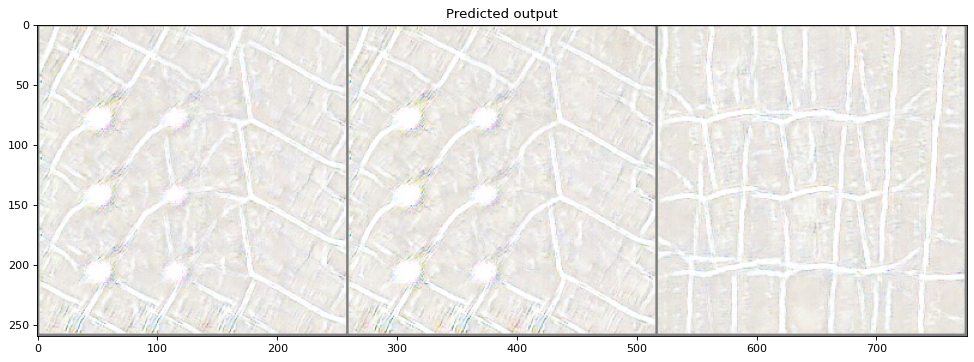

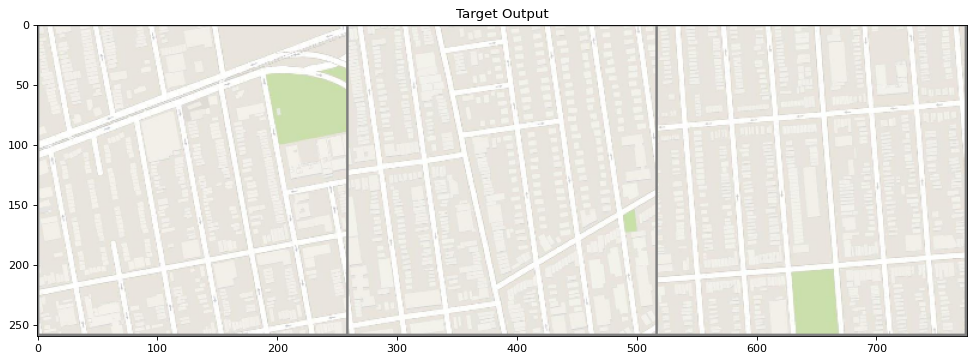

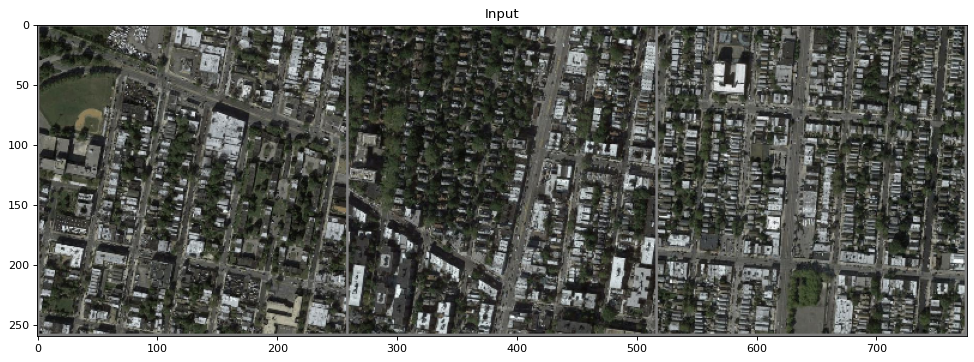

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  1.98it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.00it/s]


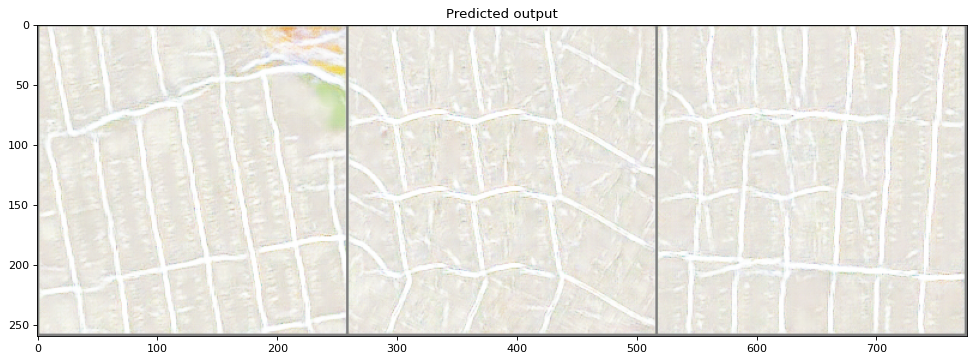

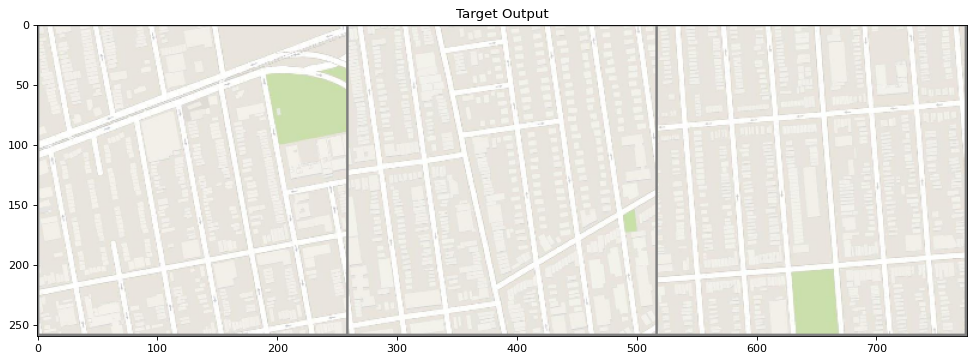

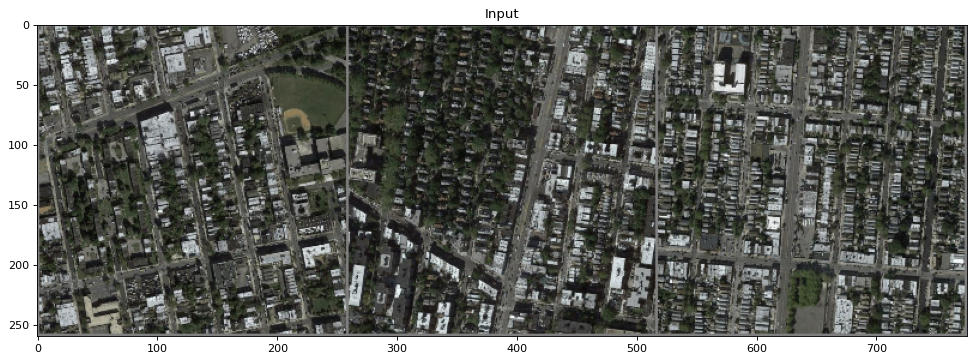

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  1.99it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


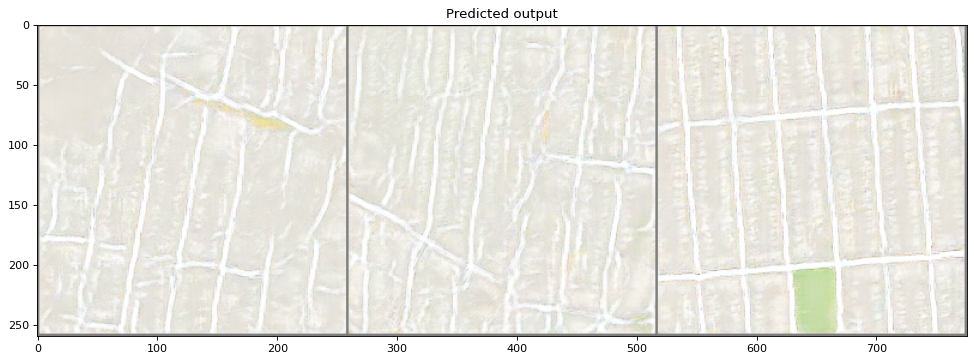

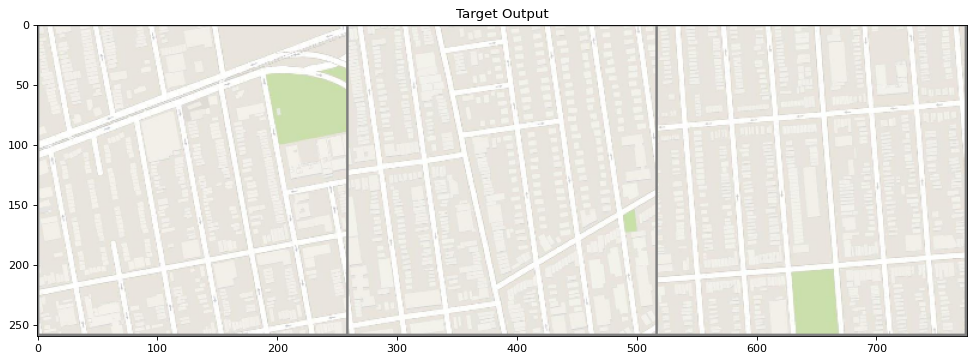

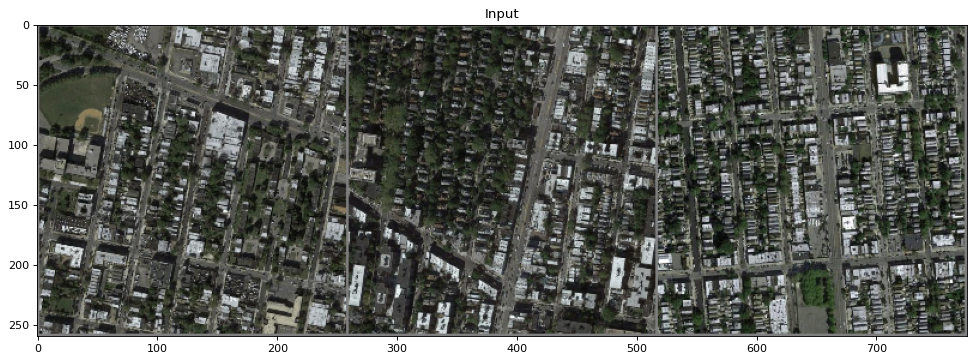

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  1.98it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  1.99it/s]


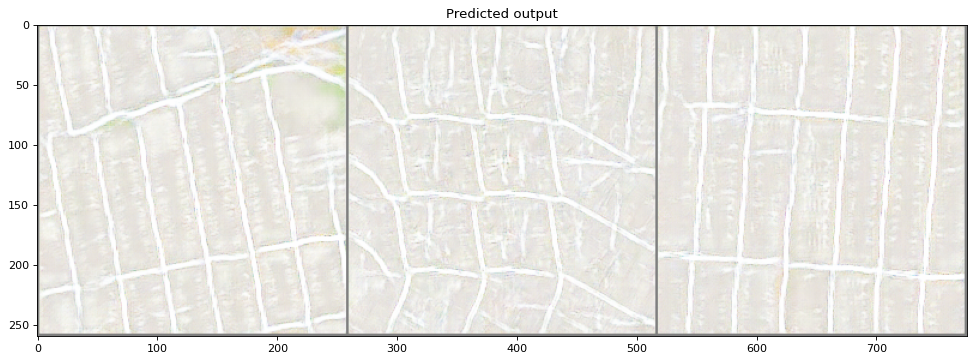

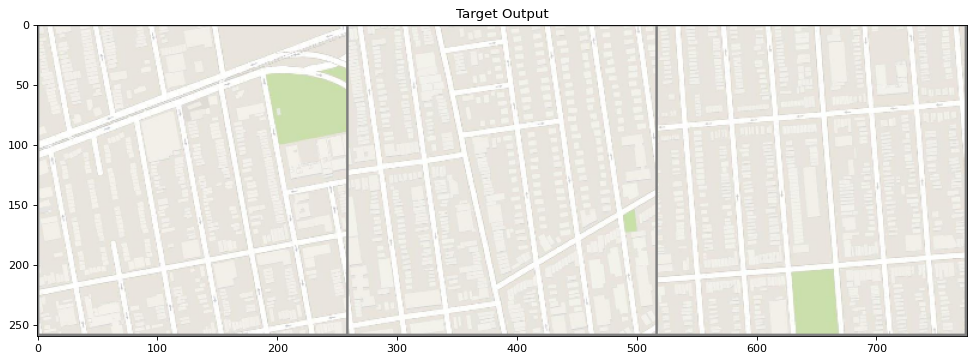

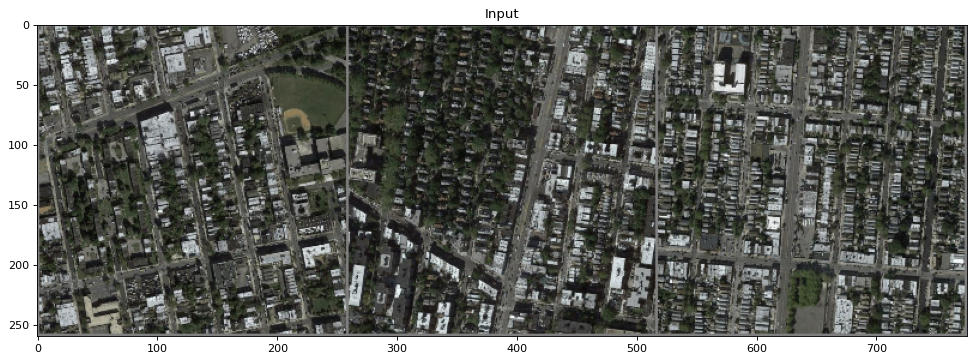

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:35<00:00,  1.97it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


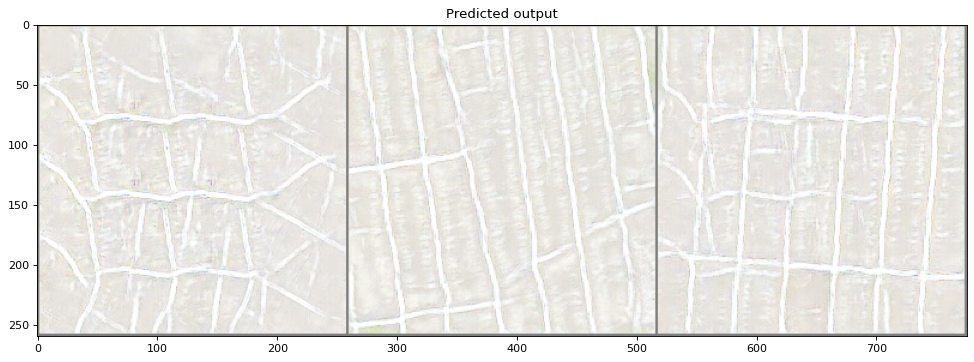

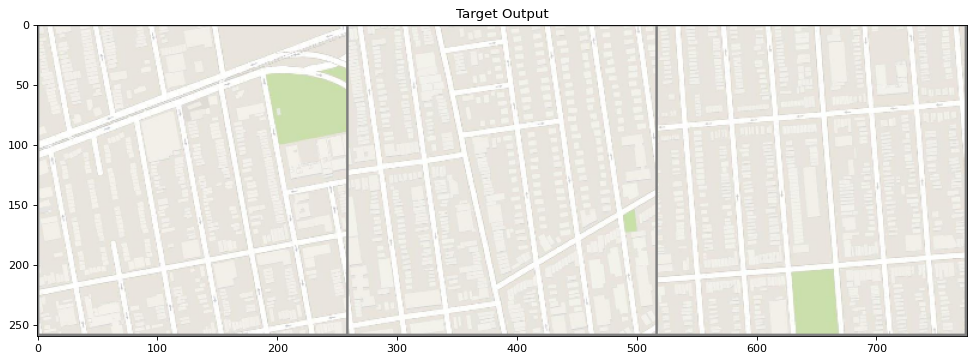

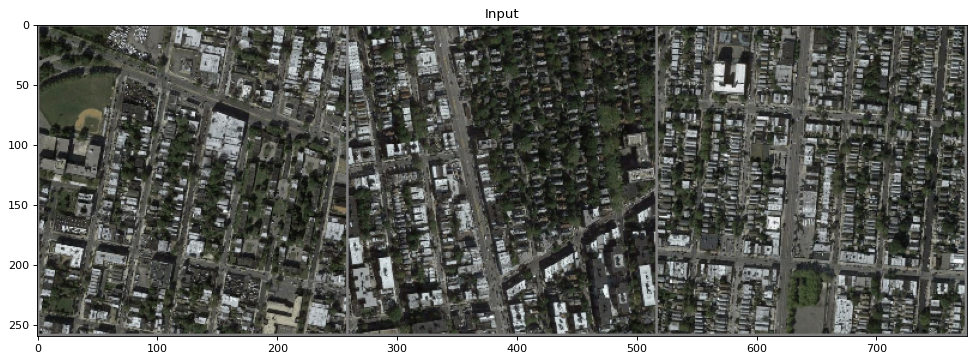

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.00it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.00it/s]


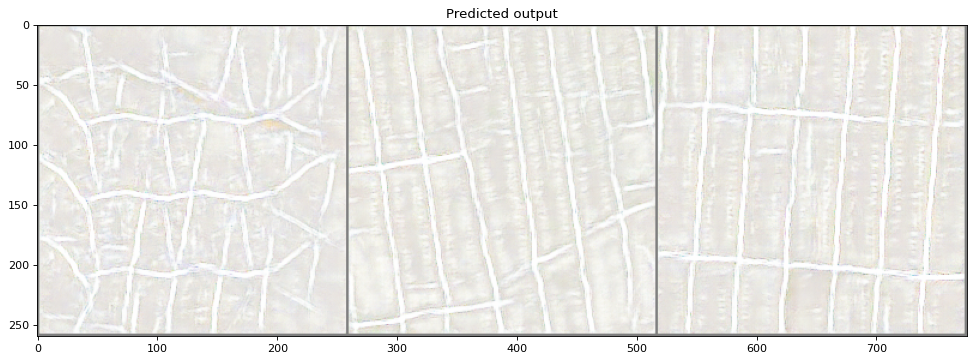

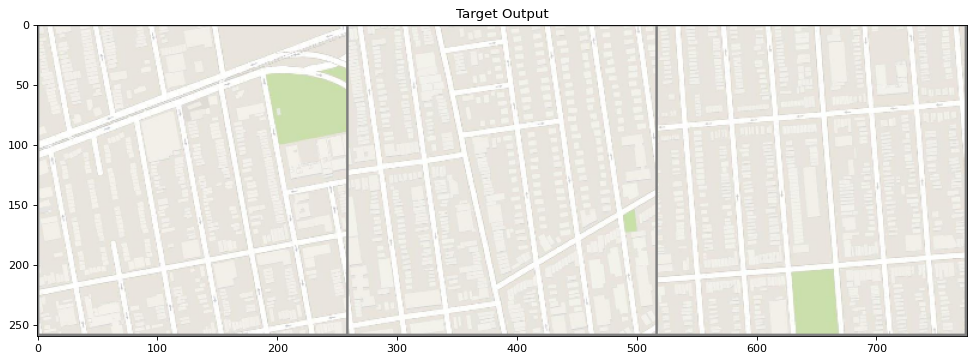

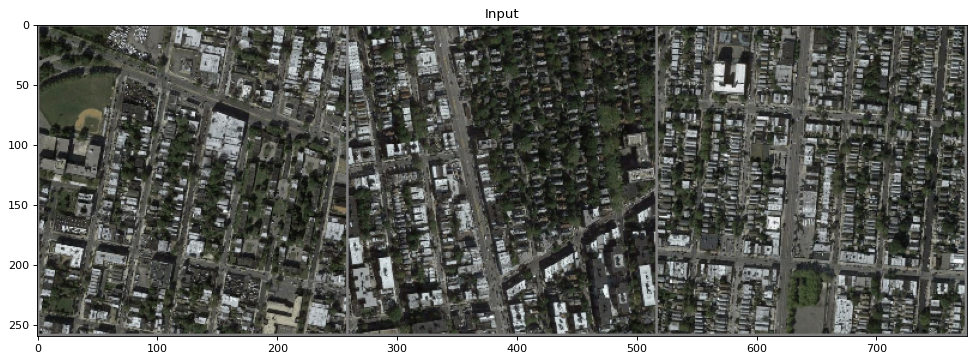

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.00it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.00it/s]


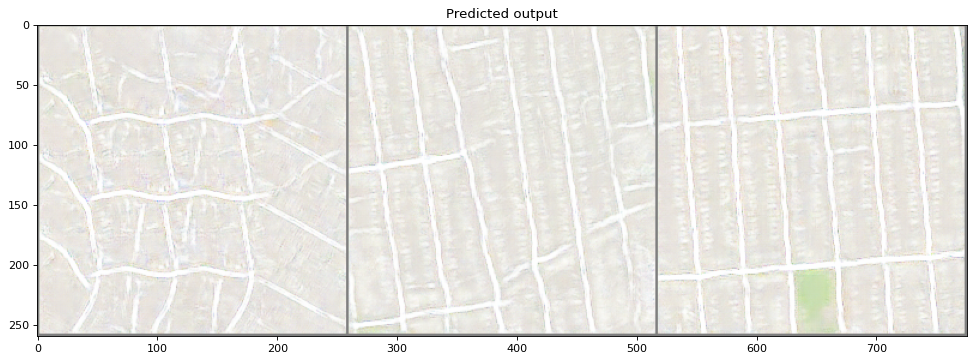

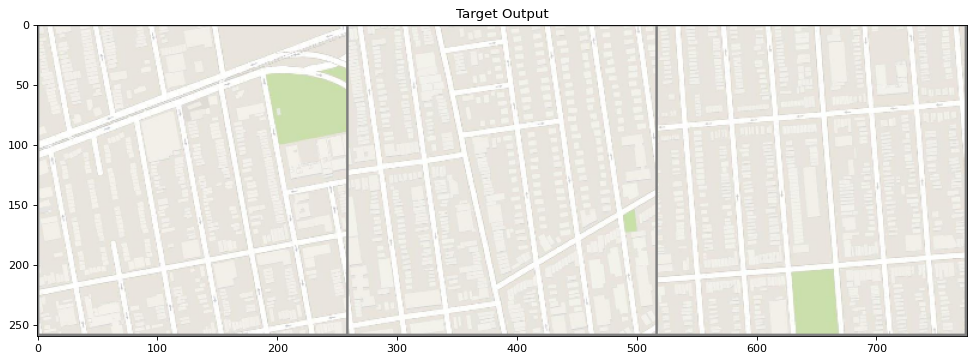

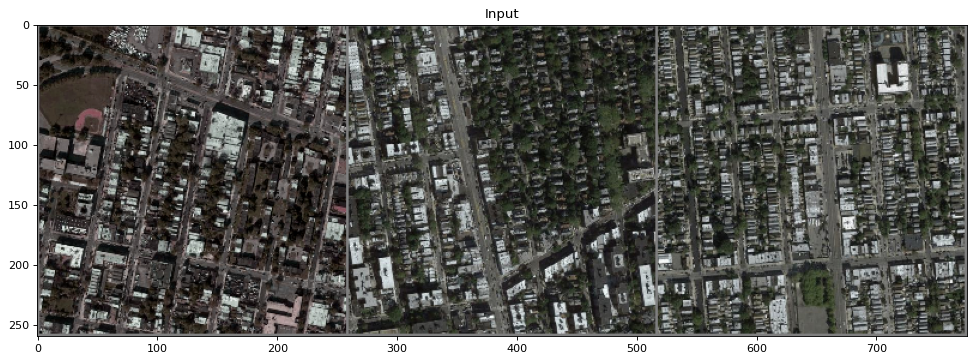

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


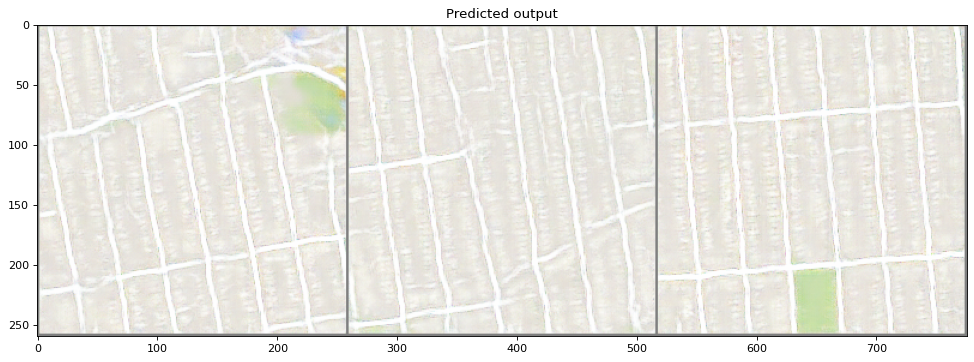

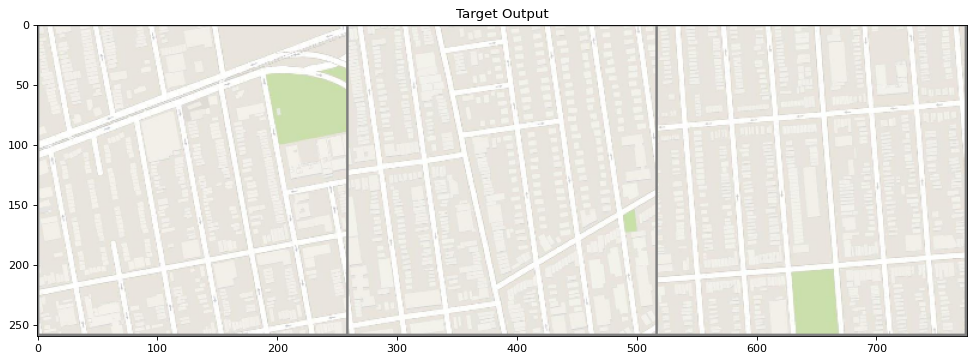

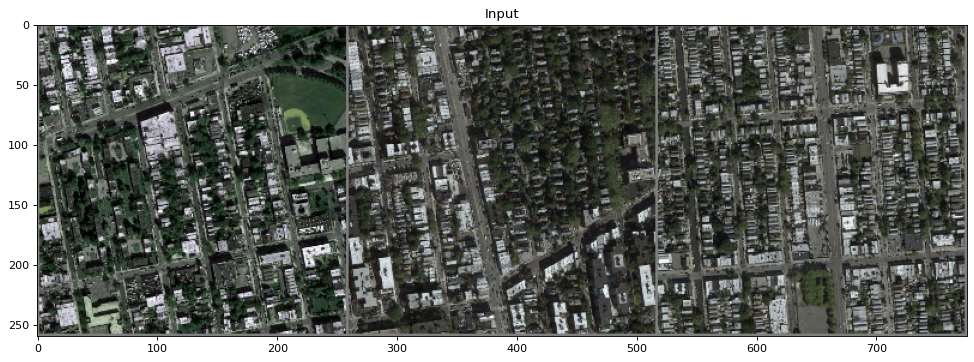

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.00it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.02it/s]


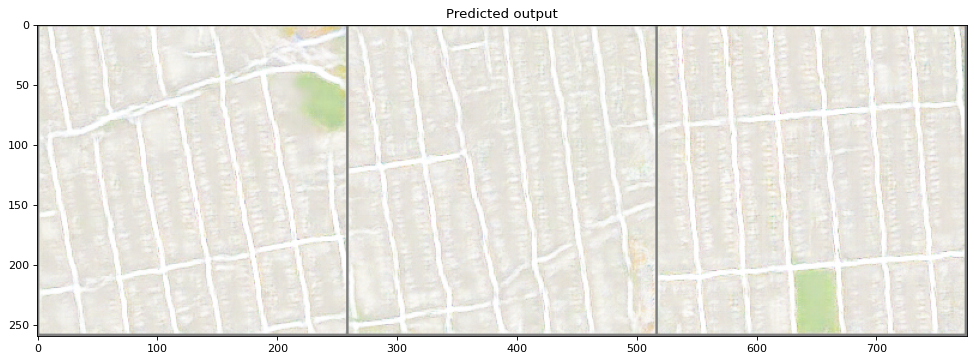

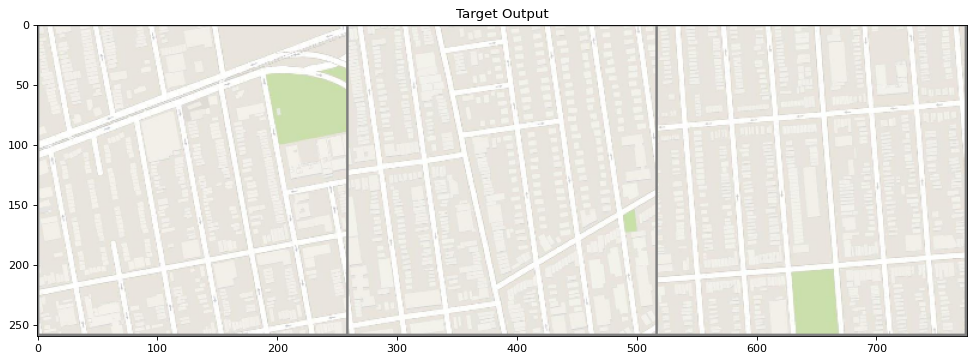

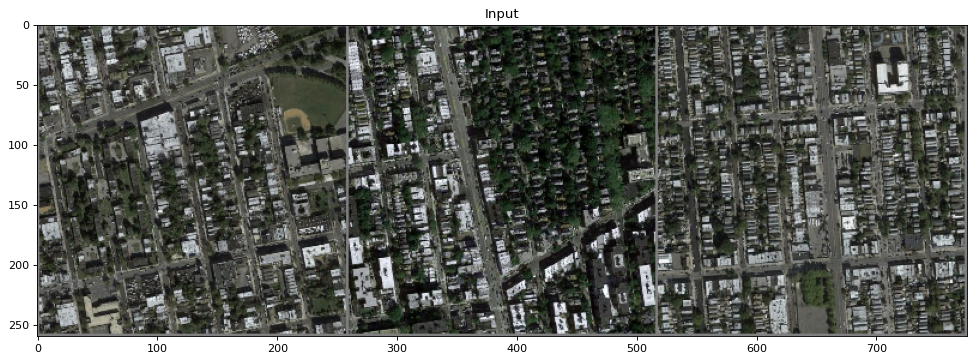

=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.02it/s]


=> Saving checkpoint
=> Saving checkpoint


100%|██████████| 69/69 [00:34<00:00,  2.01it/s]


In [ ]:


if LOAD_MODEL:
    load_checkpoint(CHECKPOINT_GEN, gen, opt_gen, LEARNING_RATE,)
    load_checkpoint(CHECKPOINT_DISC, disc, opt_disc, LEARNING_RATE,)

train_dataset = MapDataset(root_dir=TRAIN_DIR)
train_loader = DataLoader(train_dataset,batch_size=BATCH_SIZE,shuffle=True,num_workers=0,)
g_scaler = torch.cuda.amp.GradScaler() # because we dont have much ram on our laptop
d_scaler = torch.cuda.amp.GradScaler() # because we dont have much ram on our laptop
val_dataset = MapDataset(root_dir=VAL_DIR)
val_loader = DataLoader(val_dataset, batch_size=3, shuffle=False)

for epoch in range(NUM_EPOCHS):
    train_fn(disc, gen, train_loader, opt_disc, opt_gen, L1_LOSS, BCE, g_scaler, d_scaler,)

    if epoch % 10==0:
        gen.eval()
        with torch.no_grad():
            x, y = next(iter(val_loader))
            x, y = x.to(DEVICE), y.to(DEVICE)
            fake_eval = gen(x)
            show_image(torchvision.utils.make_grid(fake_eval.cpu()),'Predicted output' )
            show_image(torchvision.utils.make_grid(y.cpu()), 'Target Output')
            show_image(torchvision.utils.make_grid(x.cpu()), 'Input')
            save_some_examples(gen, val_loader, epoch, folder="dataset_maps/maps/evaluation")
        gen.train()

    if SAVE_MODEL and epoch % 5 == 0:
        save_checkpoint(gen, opt_gen, filename=CHECKPOINT_GEN)
        save_checkpoint(disc, opt_disc, filename=CHECKPOINT_DISC)




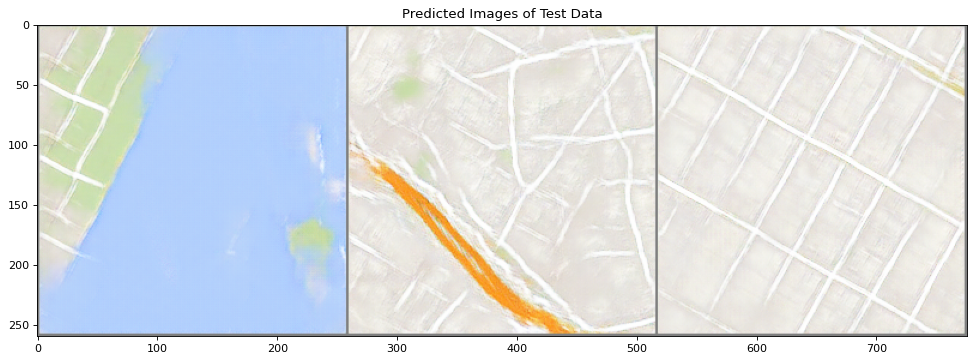

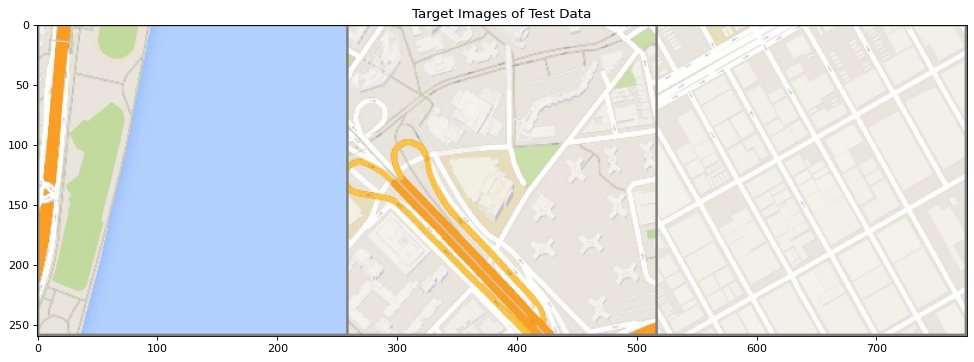

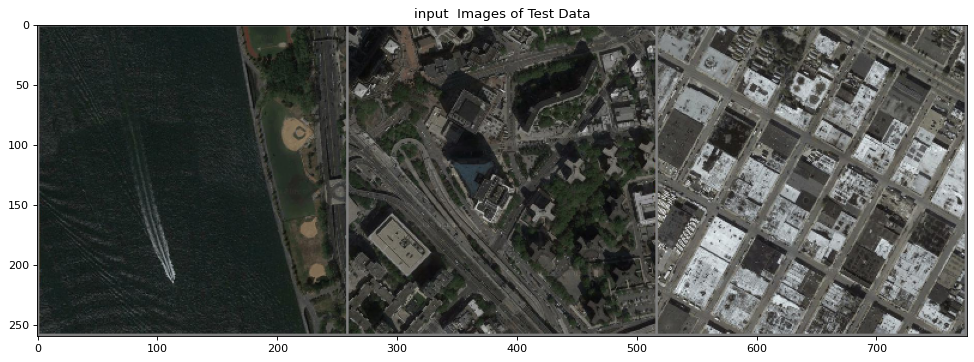

In [ ]:
gen.eval()
val_loader2 = DataLoader(val_dataset, batch_size=3, shuffle=True)
x, y = next(iter(val_loader2))
x, y = x.to(DEVICE), y.to(DEVICE)
fake_eval = gen(x)
show_image(torchvision.utils.make_grid(fake_eval.cpu()),'Predicted Images of Test Data')
show_image(torchvision.utils.make_grid(y.cpu()), 'Target Images of Test Data')
show_image(torchvision.utils.make_grid(x.cpu()), 'input  Images of Test Data')

In [ ]:
load_checkpoint(CHECKPOINT_GEN, gen, opt_gen, LEARNING_RATE,)

=> Loading checkpoint
